In [ ]:
#grid box 內的center to center offset應該要依照grid box的邊長校正到-0.5到0.5之間
#還原object map的部分也要依上述校正

#校正確認無誤後記得修改Data.py的內容

In [2]:
import tensorflow as tf
import json
import numpy as np
import cv2
import pathlib
from sklearn.model_selection import train_test_split

In [3]:
image_shape = (1024,1024)
label_folder = r'D:\Competitions\ComputerVision\OCR\Signalboard\dataset\train\label\custom'
image_folder = r'D:\Competitions\ComputerVision\OCR\Signalboard\dataset\train\image\official'
validation_ratio = 0.05
random_state = 100
batch_size = 8

object_map_param = [
    (128,(0,36)),
    (64,(37,76)),
    (32,(77,156)),
    (16,(157,316)),
    (8,(317,636)),
    (8,(637,892)),
    (8,(892,1024))
]

In [3]:
image_shape = (1024,1024)
label_folder = r'C:\Users\Atlas\Desktop\Sinalboard_OCR\dataset\train\label\custom'
image_folder = r'C:\Users\Atlas\Desktop\Sinalboard_OCR\dataset\train\image\official'
validation_ratio = 0.05
random_state = 100
batch_size = 8

object_map_param = [
    (128,(0,36)),
    (64,(37,76)),
    (32,(77,156)),
    (16,(157,316)),
    (8,(317,636)),
    (8,(637,892)),
    (8,(892,1024))
]

In [14]:
class Dataset:
    def __init__(self,label_folder,image_folder,batch_size,image_shape,object_map_param):
        self.label_folder = label_folder
        self.image_folder = image_folder
        self.batch_size = batch_size
        self.image_shape = image_shape
        self.object_map_param = object_map_param
    
    def split(self,validation_ratio,random_state):
        labels = [l.as_posix() for l in pathlib.Path(self.label_folder).iterdir()]
        train_labels, validation_labels = train_test_split(labels,test_size=validation_ratio,random_state=random_state)
        train_data = self.create_dataset(train_labels,False)
        validation_data = self.create_dataset(validation_labels,True)
        return train_data, validation_data
    
    def create_dataset(self,labels,is_validation):
        dataset = tf.data.Dataset.from_tensor_slices(labels)
        dataset = dataset.map(
            lambda path: tf.py_function(
                self.decode_json,
                [path],
                [tf.string, tf.int32, tf.float64, tf.float64, tf.float64]),
            num_parallel_calls=tf.data.AUTOTUNE
        )
        dataset = dataset.cache()
        if not is_validation:
            dataset = dataset.shuffle(buffer_size=5000)
        dataset = dataset.map(
            lambda image_path, group, center, wh, offset: tf.py_function(
                self.image_preprocess,
                [image_path, group, center, wh, offset],
                [tf.string, tf.float32, tf.int32, tf.float64, tf.float64, tf.float64]),
            num_parallel_calls=tf.data.AUTOTUNE
        )
        if not is_validation:
            dataset = dataset.map(
            lambda image_path, image, group, center, wh, offset: tf.py_function(
                self.argumentation,
                [image_path, image, group, center, wh, offset],
                [tf.string, tf.float32, tf.int32, tf.float64, tf.float64, tf.float64]),
            num_parallel_calls=tf.data.AUTOTUNE
        )
        dataset = dataset.map(
            lambda image_path, image, group, center, wh, offset: tf.py_function(
                self.transform,
                [image_path, image, group, center, wh, offset],
                [tf.string, tf.float32]+[tf.float64]*len(self.object_map_param)),
            num_parallel_calls=tf.data.AUTOTUNE
        )
        dataset = dataset.batch(self.batch_size, num_parallel_calls=tf.data.AUTOTUNE)
        dataset = dataset.prefetch(tf.data.AUTOTUNE)
        return dataset
        
    def decode_json(self,path):
        label = json.loads(tf.io.read_file(path).numpy())

        image_path = tf.strings.join([self.image_folder,label['ImageName']],'/')
        
        group = np.array([[b['type']] if b['type']!=255 else [6] for b in label['bboxes']])
        center = np.array([b['rectangle']['center'] for b in label['bboxes']])
        wh = np.array([b['rectangle']['ltwh'][2:] for b in label['bboxes']])
        
        rectangle = np.array([b['rectangle']['points'] for b in label['bboxes']])
        polygon = np.array([b['polygon']['points'] for b in label['bboxes']])
        offset = polygon - rectangle
        
        return image_path, group, center, wh, offset
    
    def image_preprocess(self, image_path, group, center, wh, offset):
        image = tf.io.decode_jpeg(tf.io.read_file(image_path))
        image = tf.image.convert_image_dtype(image,tf.float32)
        image = tf.image.resize(image,self.image_shape)
        image = tf.clip_by_value(image,0,1)
        return image_path, image, group, center, wh, offset
    
    def argumentation(self, image_path, image, group, center, wh, offset):
        group = group.numpy()
        center = center.numpy()
        wh = wh.numpy()
        offset = offset.numpy()
        
        if np.random.choice([True,False],p=[0.4,0.6]):
            if np.random.choice([True,False],p=[0.7,0.3]):
                image = tf.image.random_contrast(image,0.5,2)
                image = tf.clip_by_value(image,0,1)

            if np.random.choice([True,False],p=[0.7,0.3]):
                image = tf.image.random_hue(image,0.25)
                image = tf.clip_by_value(image,0,1)

            if np.random.choice([True,False],p=[0.7,0.3]):
                image = tf.image.random_brightness(image,0.25)
                image = tf.clip_by_value(image,0,1)

            if np.random.choice([True,False],p=[0.7,0.3]):
                image = tf.image.random_saturation(image,0.5,2)
                image = tf.clip_by_value(image,0,1)
            
        if np.random.choice([True,False],p=[0.3,0.7]):
            image, center, wh, offset = self.random_resize(image, center, wh, offset)
        
        return image_path, image, group, center, wh, offset
    
    def transform(self, image_path, image, group, center, wh, offset):
        group = group.numpy()
        center = center.numpy()
        wh = wh.numpy()
        offset = offset.numpy()
        
        determine = np.ceil(np.max(wh*np.array(self.image_shape[::-1]),axis=-1)).astype(int)
        bboxes_order = np.argsort(determine)
        group = group[bboxes_order]
        center = center[bboxes_order]
        wh = wh[bboxes_order]
        offset = offset[bboxes_order]
        
        object_maps = []
        for grid_count, object_determine_size_range in self.object_map_param:
            smallest, biggest = object_determine_size_range
            mask = ((smallest<=determine) & (determine<=biggest))

            blood = 1/(grid_count*2)
            grid_center_coor = np.linspace(0+blood,1-blood,grid_count)
            
            matched_group = group[mask]
            cxcy = center[mask]
            matched_wh = wh[mask]
            points_offset = offset[mask]

            belonging = (cxcy*grid_count).astype(int)
            match_grid_center_coor = np.stack([grid_center_coor[belonging[:,0]],grid_center_coor[belonging[:,1]]],axis=-1)

            center_offset = cxcy - match_grid_center_coor
#             center_offset = (cxcy - match_grid_center_coor)*grid_count*2
            
            answer = np.concatenate([matched_group,center_offset,matched_wh,points_offset.reshape(-1,8)],axis=-1)
            object_map = np.zeros((grid_count,grid_count,1+(1+(2+2)+(4*2))))
            object_map[belonging[:,1],belonging[:,0],0] = 1
            object_map[belonging[:,1],belonging[:,0],1:] = answer

            object_maps.append(object_map)
        return image_path, image, *object_maps
    
    
    def random_resize(self,image, center, wh, offset):
        w_rate,h_rate = np.random.uniform(0.5,1,2)
        new_shape = (np.array([h_rate,w_rate]) * image.shape[:2]).astype(int)
        
        resized_image = tf.image.resize(image,new_shape)
        resized_image = tf.clip_by_value(resized_image,0,1)
        
        center = center * np.array([w_rate,h_rate])
        wh = wh * np.array([w_rate,h_rate])
        offset = offset * np.array([w_rate,h_rate])
        
        image_x_diff = self.image_shape[1]-new_shape[1]
        image_y_diff = self.image_shape[0]-new_shape[0]
        
        image_x_offset = np.random.randint(0,image_x_diff+1)
        image_y_offset = np.random.randint(0,image_y_diff+1)
        
        new_image = tf.pad(resized_image,
                           [
                               [image_y_offset,image_y_diff-image_y_offset],
                               [image_x_offset,image_x_diff-image_x_offset],
                               [0,0]
                           ])
        
        image_offset = np.array([image_x_offset/self.image_shape[1],image_y_offset/self.image_shape[0]])
        
        center = center + image_offset
        
        return new_image, center, wh, offset

In [15]:
t,v = Dataset(label_folder,image_folder,batch_size,image_shape,object_map_param).split(validation_ratio,random_state)

In [21]:
0.00097656 * 128 * 2

0.24999936

[[ 1.02163462e-03 -2.44140625e-03]
 [ 3.06204212e-04  3.41796875e-03]
 [ 6.58195971e-05 -2.92968750e-03]
 [-1.74851190e-03 -9.76562500e-04]
 [-2.66140110e-04 -2.44140625e-03]
 [-1.11320971e-03  9.76562500e-04]
 [ 3.65441850e-03  2.44140625e-03]
 [-1.33642399e-03  2.92968750e-03]
 [-1.21623168e-03 -4.88281250e-04]
 [-8.15590659e-04 -1.46484375e-03]]
[[ 0.26153846 -0.625     ]
 [ 0.07838828  0.875     ]
 [ 0.01684982 -0.75      ]
 [-0.44761905 -0.25      ]
 [-0.06813187 -0.625     ]
 [-0.28498168  0.25      ]
 [ 0.93553114  0.625     ]
 [-0.34212454  0.75      ]
 [-0.31135531 -0.125     ]
 [-0.20879121 -0.375     ]]
[[ 0.00766369 -0.00244141]
 [-0.00195169  0.00585938]
 [-0.00329098  0.00585938]
 [ 0.00123054 -0.0078125 ]
 [ 0.00390911  0.00097656]
 [ 0.00599245  0.00195312]
 [-0.00428686  0.00683594]]
[[ 0.98095238 -0.3125    ]
 [-0.24981685  0.75      ]
 [-0.42124542  0.75      ]
 [ 0.15750916 -1.        ]
 [ 0.5003663   0.125     ]
 [ 0.76703297  0.25      ]
 [-0.54871795  0.875     ]

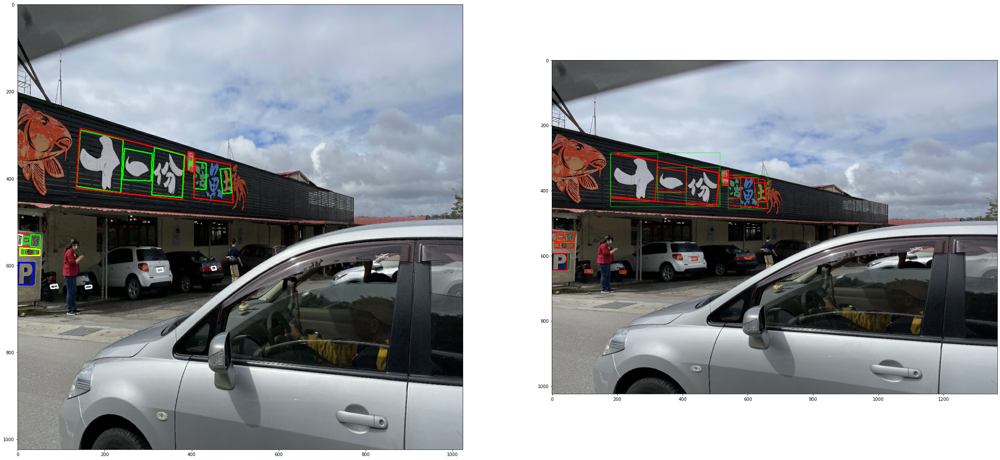

[[ 0.00273294  0.        ]
 [ 0.00236092 -0.00097656]
 [ 0.00090717 -0.00244141]
 [-0.00060955  0.00292969]
 [-0.00287031 -0.00341797]]
[[ 0.6996337   0.        ]
 [ 0.6043956  -0.25      ]
 [ 0.23223443 -0.625     ]
 [-0.15604396  0.75      ]
 [-0.73479853 -0.875     ]]
[[-0.0013679   0.00390625]
 [-0.00400069  0.00585938]
 [ 0.00564904 -0.00292969]
 [-0.00758356  0.00146484]
 [-0.00243246  0.00439453]
 [ 0.00722871  0.00292969]
 [-0.00166552  0.00146484]
 [ 0.00433265  0.        ]]
[[-0.17509158  0.5       ]
 [-0.51208791  0.75      ]
 [ 0.72307692 -0.375     ]
 [-0.97069597  0.1875    ]
 [-0.31135531  0.5625    ]
 [ 0.92527473  0.375     ]
 [-0.21318681  0.1875    ]
 [ 0.55457875  0.        ]]
[[-0.01019918 -0.01416016]
 [ 0.01239698  0.00537109]
 [-0.00289606  0.00830078]
 [ 0.00694826 -0.00244141]
 [-0.0137935   0.00683594]
 [ 0.00033196 -0.01513672]
 [ 0.00694826 -0.00292969]
 [-0.0079098  -0.00537109]]
[[-0.65274725 -0.90625   ]
 [ 0.79340659  0.34375   ]
 [-0.18534799  0.53125 

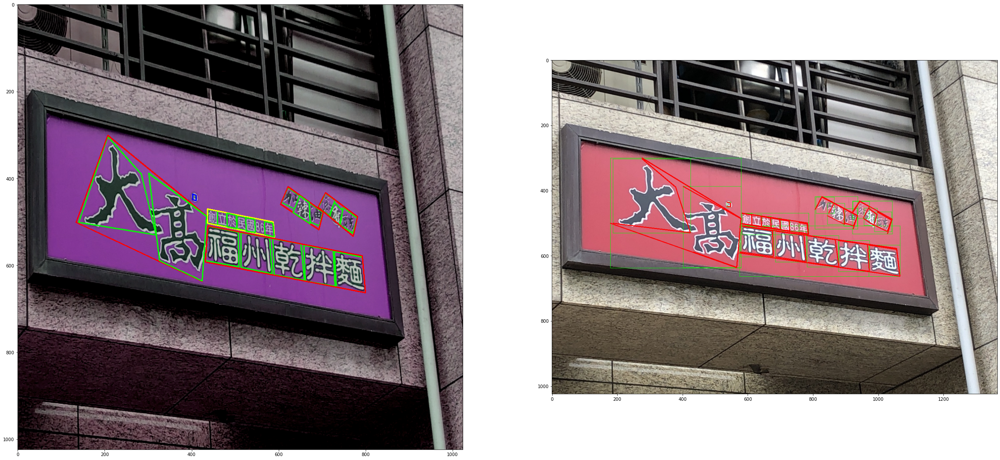

[[-0.00292969 -0.00048828]
 [-0.00048828  0.00244141]
 [ 0.00195312 -0.00341797]
 [ 0.00146484  0.        ]
 [-0.00146484  0.00341797]]
[[-0.75  -0.125]
 [-0.125  0.625]
 [ 0.5   -0.875]
 [ 0.375  0.   ]
 [-0.375  0.875]]
[[ 0.          0.00244141]
 [-0.00341797  0.00439453]
 [ 0.00390625  0.00439453]
 [ 0.00292969  0.00634766]
 [ 0.00048828  0.00683594]
 [-0.00195312 -0.0078125 ]
 [ 0.00585938 -0.00732422]
 [ 0.00537109  0.00390625]
 [ 0.00390625  0.00732422]
 [ 0.         -0.00195312]
 [-0.00048828 -0.00439453]
 [-0.00634766  0.00585938]
 [-0.00683594  0.00195312]
 [-0.00292969  0.00488281]
 [-0.00244141  0.00439453]
 [ 0.00244141  0.00341797]
 [ 0.00292969  0.00585938]]
[[ 0.      0.3125]
 [-0.4375  0.5625]
 [ 0.5     0.5625]
 [ 0.375   0.8125]
 [ 0.0625  0.875 ]
 [-0.25   -1.    ]
 [ 0.75   -0.9375]
 [ 0.6875  0.5   ]
 [ 0.5     0.9375]
 [ 0.     -0.25  ]
 [-0.0625 -0.5625]
 [-0.8125  0.75  ]
 [-0.875   0.25  ]
 [-0.375   0.625 ]
 [-0.3125  0.5625]
 [ 0.3125  0.4375]
 [ 0.375   0.7

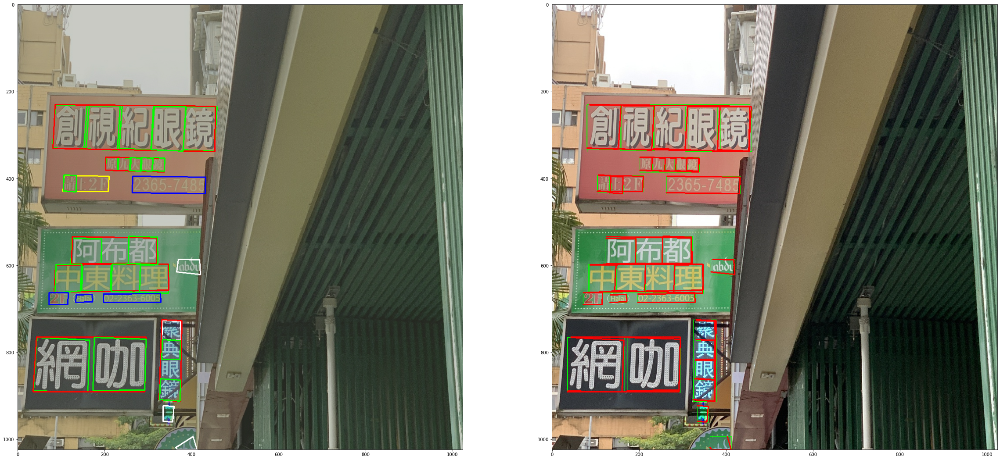

[]
[]
[]
[]
[]
[]
[[ 0.02548077 -0.00439453]
 [-0.0279533   0.02880859]
 [-0.01806319  0.00976562]
 [-0.01188187 -0.01708984]
 [-0.00048077 -0.01269531]]
[[ 0.81538462 -0.140625  ]
 [-0.89450549  0.921875  ]
 [-0.57802198  0.3125    ]
 [-0.38021978 -0.546875  ]
 [-0.01538462 -0.40625   ]]
[[ 0.05508242  0.00634766]
 [-0.04711538  0.04150391]]
[[ 0.88131868  0.1015625 ]
 [-0.75384615  0.6640625 ]]
[]
[]
[]
[]
(1024, 1820, 3)


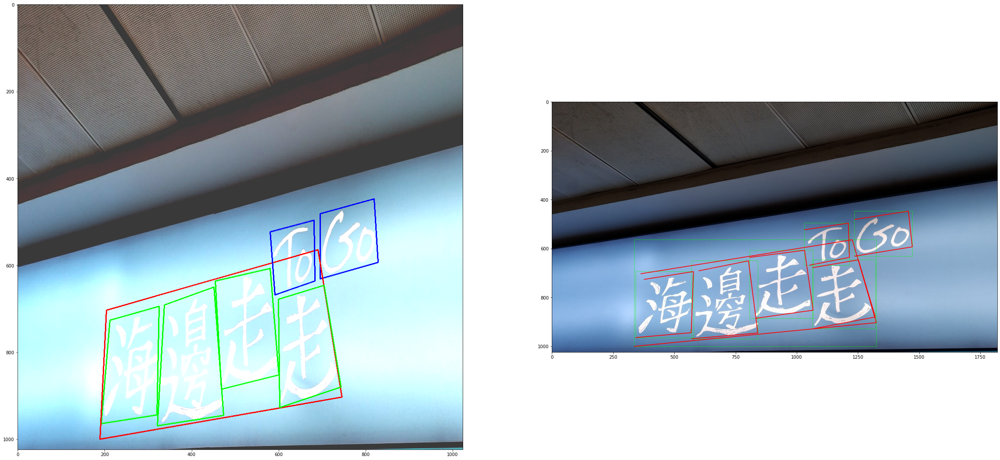

[[ 2.03468407e-03 -3.90625000e-03]
 [-2.22355769e-03 -1.46484375e-03]
 [-1.23340201e-03  4.88281250e-04]
 [-1.33070055e-03 -3.90625000e-03]
 [ 1.12465659e-03 -1.46484375e-03]
 [ 1.38221154e-03 -4.88281250e-04]
 [-2.85313645e-03  1.95312500e-03]
 [-8.89995421e-04  2.92968750e-03]
 [-5.80929487e-04  3.41796875e-03]
 [ 3.05345696e-03  4.88281250e-04]
 [ 4.95077839e-04  0.00000000e+00]
 [-2.79590201e-03  1.46484375e-03]
 [ 2.09191850e-03  1.95312500e-03]
 [ 5.12248168e-04  2.44140625e-03]
 [-2.87603022e-03 -3.41796875e-03]
 [ 7.64079670e-04  1.46484375e-03]
 [-9.41506410e-04  1.46484375e-03]
 [-2.64709249e-03  9.76562500e-04]
 [ 3.45982143e-03  1.95312500e-03]
 [ 1.38793498e-03  1.95312500e-03]
 [ 2.61847527e-03  2.44140625e-03]
 [-2.06902473e-03  0.00000000e+00]
 [ 2.33230311e-03  9.76562500e-04]
 [-1.07886905e-03  9.76562500e-04]
 [ 3.81467491e-03  1.95312500e-03]
 [ 3.72023810e-05  1.46484375e-03]
 [ 3.33962912e-03  1.95312500e-03]
 [ 4.20673077e-04  3.41796875e-03]
 [-1.15327381e-03 -3

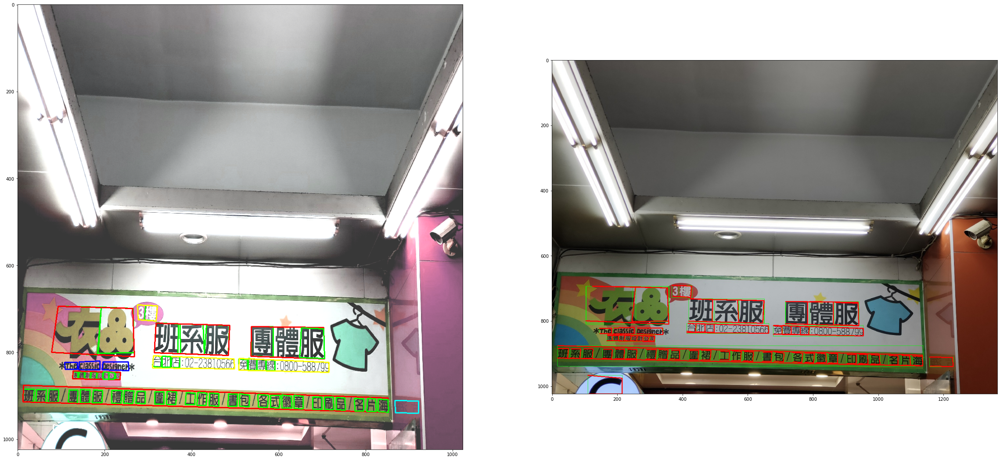

[]
[]
[]
[]
[[ 0.00341797  0.01347299]
 [-0.00927734 -0.00749771]
 [-0.01220703  0.01191621]]
[[ 0.21875     0.86227106]
 [-0.59375    -0.47985348]
 [-0.78125     0.76263736]]
[[0.01123047 0.03010531]]
[[0.359375   0.96336996]]
[[0.04296875 0.01753663]]
[[0.6875     0.28058608]]
[]
[]
[]
[]
(1365, 1024, 3)


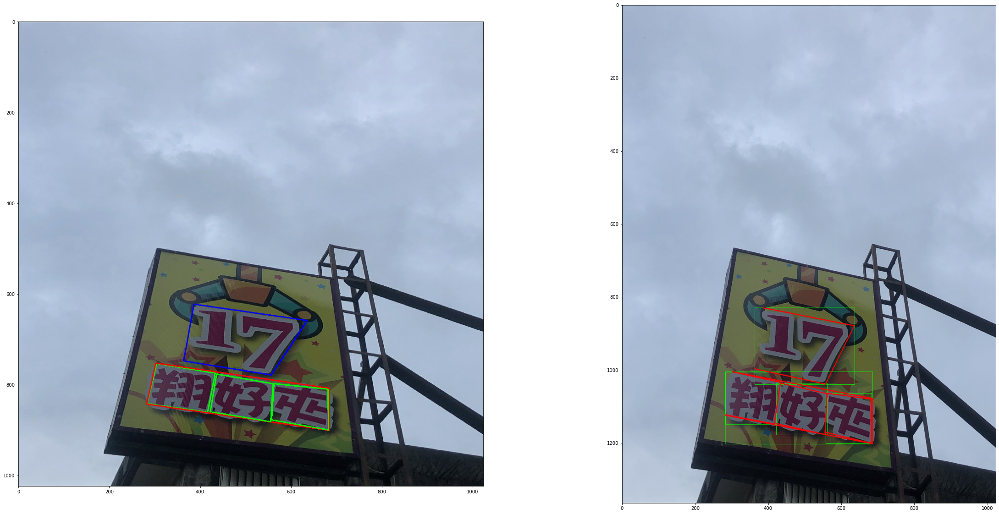

[[ 4.88281250e-04 -4.29258242e-05]
 [ 3.41796875e-03 -1.62831960e-03]]
[[ 0.125      -0.01098901]
 [ 0.875      -0.41684982]]
[[-0.00048828  0.00047505]
 [ 0.00537109  0.00459592]
 [-0.00341797 -0.00553457]
 [-0.00439453 -0.00284455]
 [-0.00585938 -0.00174565]
 [ 0.00097656  0.00131067]
 [ 0.00439453  0.00460737]
 [-0.00585938  0.00010875]
 [-0.00537109  0.00047505]
 [ 0.00048828 -0.00099016]
 [ 0.00537109 -0.00135646]
 [-0.00244141 -0.00135646]
 [ 0.00683594 -0.00318796]
 [ 0.00341797 -0.00244391]]
[[-0.0625      0.06080586]
 [ 0.6875      0.58827839]
 [-0.4375     -0.70842491]
 [-0.5625     -0.36410256]
 [-0.75       -0.22344322]
 [ 0.125       0.16776557]
 [ 0.5625      0.58974359]
 [-0.75        0.01391941]
 [-0.6875      0.06080586]
 [ 0.0625     -0.12673993]
 [ 0.6875     -0.17362637]
 [-0.3125     -0.17362637]
 [ 0.875      -0.40805861]
 [ 0.4375     -0.31282051]]
[[ 0.01123047 -0.00285027]
 [-0.00048828 -0.00321658]
 [ 0.00146484  0.00191163]
 [ 0.00976562  0.00410943]
 [ 0.013

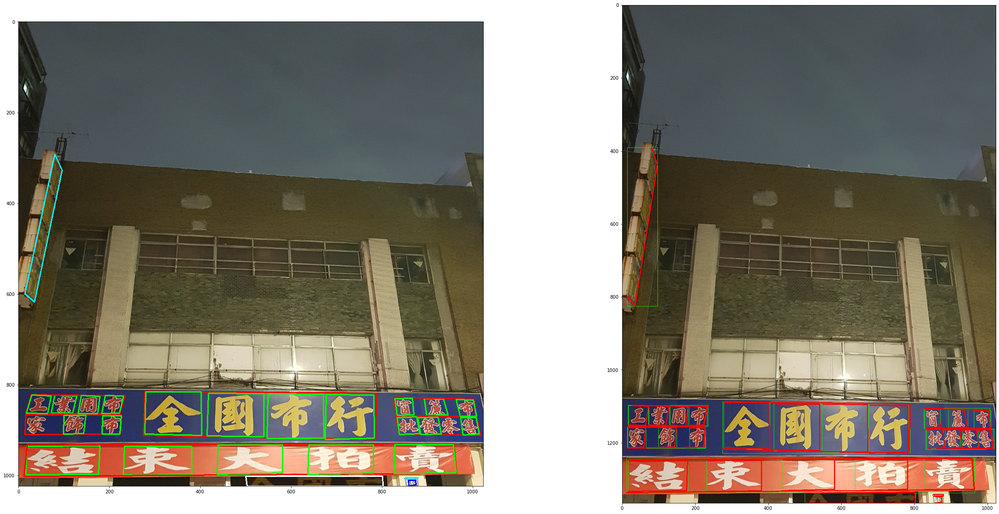

[[-3.41796875e-03 -3.90052656e-03]
 [-1.46484375e-03 -5.43727106e-05]
 [ 3.41796875e-03  2.50972985e-03]
 [-2.44140625e-03 -2.97332875e-03]
 [-3.41796875e-03 -4.09226190e-04]
 [-4.88281250e-04  6.89674908e-04]
 [ 0.00000000e+00  3.25377747e-03]
 [-9.76562500e-04  2.04613095e-03]]
[[-0.875      -0.9985348 ]
 [-0.375      -0.01391941]
 [ 0.875       0.64249084]
 [-0.625      -0.76117216]
 [-0.875      -0.1047619 ]
 [-0.125       0.17655678]
 [ 0.          0.83296703]
 [-0.25        0.52380952]]
[[ 0.00341797 -0.00552312]
 [-0.00146484 -0.00256983]
 [-0.00292969  0.00184867]
 [-0.00585938  0.00590087]
 [-0.00585938 -0.00127633]
 [ 0.00488281  0.00202038]
 [ 0.00048828  0.00238668]
 [ 0.00390625  0.00568338]
 [ 0.00292969  0.00568338]
 [ 0.00146484 -0.00699977]
 [-0.00537109 -0.00590087]
 [-0.00195312  0.00448146]
 [-0.00585938  0.00277587]
 [ 0.00683594  0.00387477]
 [ 0.00439453  0.00424107]
 [ 0.         -0.00259272]
 [-0.00683594 -0.00772092]
 [ 0.         -0.00112752]]
[[ 0.4375     -

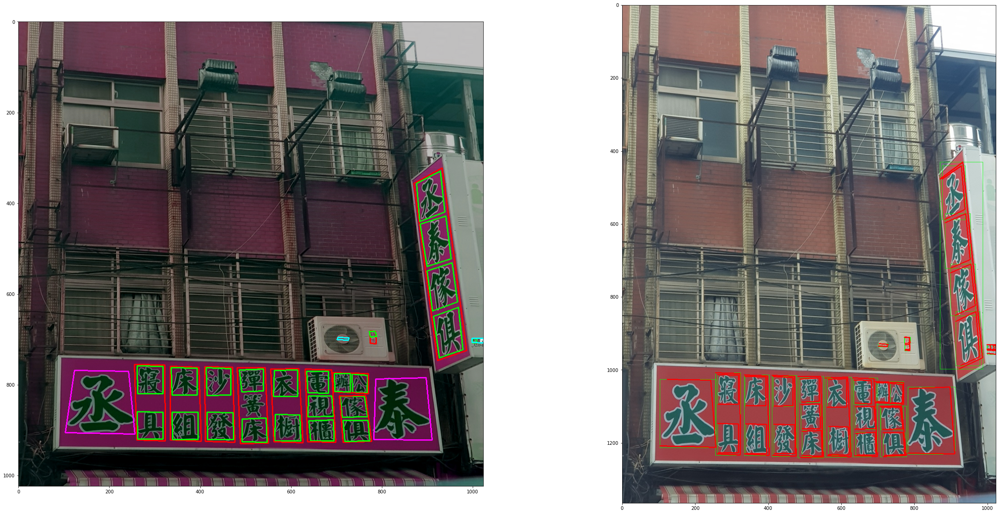

In [22]:
import matplotlib.pyplot as plt

for i in zip(*next(iter(t.take(1)))):
    path,img,omaps = i[0],i[1],i[2:]

    polygons = []
    for omap in omaps:
        omap = omap.numpy()
        loc = np.where(omap[...,0] == 1)

        grid_count = omap.shape[0]
        blood = 1/(grid_count*2)
        grid_center_coor = np.linspace(0+blood,1-blood,grid_count)

        match_grid_center_coor = np.stack([grid_center_coor[loc[1]],grid_center_coor[loc[0]]],axis=-1)
        ans = omap[loc[0],loc[1],:]
        print(ans[:,[2,3]])
        print(ans[:,[2,3]]*grid_count*2)
#         center_offset = (ans[:,[2,3]])/(grid_count*2)
        
        center_offset = ans[:,[2,3]]
        wh = ans[:,[4,5]]
        polygon_offset = ans[:,6:].reshape(-1,4,2)
        center = center_offset + match_grid_center_coor
        rect = np.stack([
            center + wh/2*np.array([-1,-1]),
            center + wh/2*np.array([1,-1]),
            center + wh/2*np.array([1,1]),
            center + wh/2*np.array([-1,1]),
        ],axis=1)

        polygon = polygon_offset + rect
        group = ans[:,1].astype(int)
        colors = [
            (1,0,0),
            (0,1,0),
            (0,0,1),
            (1,1,0),
            (1,0,1),
            (0,1,1),
            (1,1,1),
        ]
        polygon = (polygon*np.array([img.shape[1],img.shape[0]])).astype(int)
        polygons.extend(zip(polygon,map(lambda c: colors[c],group)))
    
    img = img.numpy()
    for p,c in polygons:
        img = cv2.polylines(img,[p],True,c,2)

    plt.figure(figsize=(40,20))
    plt.subplot(1,2,1)
    plt.imshow(img)

    name = str(path.numpy()).split('/')[-1].replace(".jpg'",'.json')
#     x = json.loads(pathlib.Path(r'C:\Users\Atlas\Desktop\Sinalboard_OCR\dataset\train\label\custom').joinpath(name).read_text(encoding='utf8'))
#     img = plt.imread(pathlib.Path(r'C:\Users\Atlas\Desktop\Sinalboard_OCR\dataset\train\image\official').joinpath(x['ImageName']))
    
    x = json.loads(pathlib.Path(r'D:\Competitions\ComputerVision\OCR\Signalboard\dataset\train\label\custom').joinpath(name).read_text(encoding='utf8'))
    img = plt.imread(pathlib.Path(r'D:\Competitions\ComputerVision\OCR\Signalboard\dataset\train\image\official').joinpath(x['ImageName']))
    print(img.shape)

    rects = np.array([b['rectangle']['points'] for b in x['bboxes']])
    rects = (rects * np.array([x['ImageWidth'],x['ImageHeight']])).astype(int)

    polygon = np.array([b['polygon']['points'] for b in x['bboxes']])
    polygon = (polygon * np.array([x['ImageWidth'],x['ImageHeight']])).astype(int)

    img = cv2.polylines(img,rects,True,(0,255,0))
    img = cv2.polylines(img,polygon,False,(255,0,0),2)

    plt.subplot(1,2,2)
    plt.imshow(img)
    plt.show()